<h1 style="text-align:center">   
      <font color = #00abf0 >
            <span style='font-family:Georgia'>
                Capstone Project: Style Transfer Using GAN
        </font>    
</h1>
<h3 style="text-align:right">   
      <font color = gray >
            <span style='font-family:Georgia'>
                By : Ravi Prakash Gupta
            </span>   
        </font>    
                

<a id="toc"></a>
<div class="list-group" id="list-tab" role="tablist">
<h1 class="list-group-item list-group-item-action active" data-toggle="list"  role="tab" aria-controls="home">
    <span style='font-family:Georgia'>
    Table of Content
    </span>
</h1>
<span style='font-family:Georgia'>
    <ul>
        <li><a href='#1'>1. Introduction</a></li>
        <ul>
            <li><a href='#1.1'>1.1 Background</a></li>
            <li><a href='#1.2'>1.2 Problem Statement</a></li>
            <li><a href='#1.3'>1.3 Dataset</a></li>
             <li><a href='#1.4'>1.4 Solution</a></li>
        </ul>
        <li><a href='#2'>2. Basic Understanding</a></li>
        <ul>
            <li><a href='#2.1'>2.1 Brain Tumors</a></li>
            <li><a href='#2.2'>2.2 MRI Images</a></li>
        </ul>
        <li><a href='#3'>3. Project Pipeline</a></li>
        <ul>
            <li><a href='#3.1'>3.1 Data Preparation and Understanding
            <ul> 
                <li><a href='#3.1.1'> Importig Python Libraries</a></li> 
                <li><a href='#3.1.2'> Data Loading</a></li> 
                <li><a href='#3.1.3'> Data Visualization</a>
</ul>
            </a></li>
            <li><a href='#3.2'>3.2 Data Preprocessing</a></li>
            <li><a href='#3.3'>3.3 Model Building</a></li>
            <ul> 
                <li><a href='#3.3.1'> Instance Normalization</a></li> 
                <li><a href='#3.3.2'> Downsampling, Upsampling and Unet</a></li> 
                <li><a href='#3.3.3'> Generator Building Using Unet</a>
                <li><a href='#3.3.3'> Discriminator</a>
</ul>            
            <li><a href='#3.4'>3.4 Model Training</a></li>  
        </ul>
        <li><a href='#4'>4. Results</a></li>
        <li><a href='#5'>5. Conlcusion</a></li>
        <li><a href='#6'>6. References</a></li>
    </ul>
</span>

<a id="1"></a>
## 1. Introduction

<a id="1.1"></a>
### 1.1 Backgroud
Misdiagnosis in the medical field is a very serious and common issue. Medical Imaging procedures requires radiologist’s opinion which may vary from one radiologist to others. This can lead to conflicting reports and resulting in poor recommend treatment options to the patient.

For interpreting the MRI(Magnetic Resonance Imaging) scan, the radiologist needs different variations of the imaging. But to have access to different imaging is difficult and expensive. 
<br>With the help of deep learning, we can use style transfer to generate artificial MRI images of different contrast levels from existing MRI scans. This will help to provide a better diagnosis with the help of an additional image.
 
<a id="1.2"></a> 
### 1.2 Problem Statemet
To build a Generative adversarial model(modified U-Net) which can generate artificial MRI images of different contrast levels from existing MRI scans.

<a id="1.3"></a> 
### 1.3 Dataset
We will be using the dataset provided to us in a zipped file "MRI T1_T2 Dataset". It has two folders which contains unpaired images.

<a id="1.4"></a> 
### 1.4 Solution
In this capstone, we will use CycleGAN to translate the style of one MRI image to another, which will help in a better understanding of the scanned image. Using GANs we will create T2 weighted images from T1 weighted MRI image and vice-versa.
 



<a id="2"></a> 
## 2. Basic Understanding

<a id="2.1"></a> 
### 2.1 Brain Tumors
Primary brain tumor arises when there is uncontrolled division of cells forming an abnormal group of cells around or inside the brain. That group of cells can affect the normal functionality of the brain activity and destroy the healthy cells. Brain tumors classified to benign or low-grade (grade I and II) and malignant tumors or high-grade (grade III and IV). 

- Glioblastoma: It is the primary malignant brain tumors that is  classified as Grade IV. It usually starts in the cerebrum.
- Sarcoma: It has different grades that vary from grade I to grade IV and it arises in the connective tissues like blood vessels.
- Metastatic bronchogenic carcinoma: It is the secondary malignant brain tumors that spreads to the brain from broncho- genic carcinoma lung tumor.


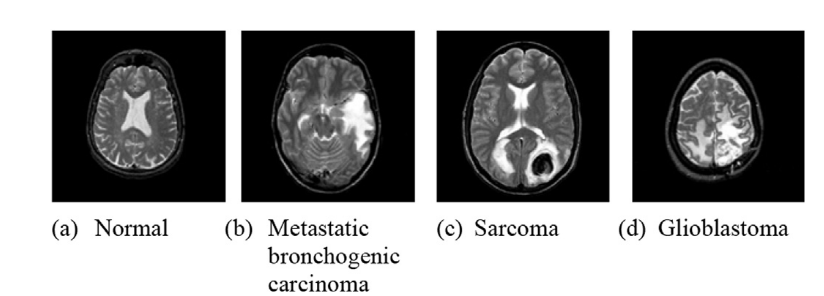

<a id="2.2"></a> 
### 2.2 MRI Images 

Brain magnetic resonance imaging (MRI) is one of the best imaging techniques that is used for detecting the brain tumors and modeling of the tumor progression in both the detection and the treatment phases. It helps us to visualize anatomy in all three planes: axial, sagittal and coronal (see the example image below).

![img](https://i.ibb.co/S0wCMqc/image.png)

#### MRI Imaging Process
- A powerful magnetic field is employed to align the protons that are normally randomly oriented within the water nuclei of the tissue. 
- This alignment (or magnetization) is next disrupted by introduction of an external Radio Frequency (RF) energy. When the nuclei relaxes it emits RF signals (energy) which are measured.
- Fourier Transform is used to convert the frequency information contained in the signal from each location in the imaged plane to corresponding intensity levels, which are then displayed as shades of gray in a matrix arrangement of pixels. 
By varying the sequence of RF pulses applied & collected, different types of images are created.


**T1 and T2 are different MRI Imaging Sequence that has pros and cons over each other.**
* T1 : Tissue with high water content will apear dark(grey) and tissue with low water content will appear white/brighter.
* T2 : Tissue with high water content will appear white/brighter whereas tissue with low water content will appear dark(grey)

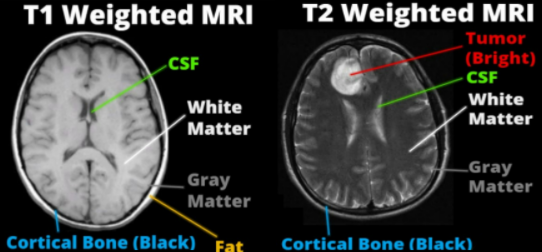


|Type|T1 Highlight Style|T2 Highlight Style|
|:-:|:-:| :-:|
| Water | Dark | Very Bright |
Fat|Very Bright|Dark
Bone|Dark|Dark
Muscle|Intermediate|Dark
Tumours|Intermediate|Bright


<a id="3"></a> 
## 3. Project Pipeline
The project pipeline can be briefly summarized in the following four steps:
- Data Understanding: Here, we load the data and create the dataset for it.
- Image Processing: In this step, we process the images using different steps.
- Model-Building and Training: This is the final step at which We create our Generators and Discriminators using a modified U-Net architecture(similar to CycleGAN). We also define the loss function and training step for model training.

The sequence of the project pipeline is as below:

1. Data Preparation and Understanding
2. Data Preprocessing
3. Model Building
4. Model Training
5. Result

<a id="3.1"> </a>
### 3.1 Data Preparation and Understanding

<a id="3.1.1"> </a>
#### Important Python Libraries

In [1]:
# Installing all the necessary libraries
!pip install matplotlib
!pip install scikit-image
!pip install glob
!pip install keras
!pip install imageio

ERROR: Could not find a version that satisfies the requirement glob (from versions: none)
ERROR: No matching distribution found for glob


In [2]:
#importing all the important libraries

#Data handling libraries
import numpy as np
import imageio
import glob
import os

#Visualisation Libraries
import matplotlib.pyplot as plt

#DL Model Libraries
import tensorflow as tf
from skimage.transform import resize
from keras.utils.vis_utils import plot_model


<a id="3.1.2"> </a>
#### Data Loading


In [3]:
#Loading the dataset folder path
t1_path=os.path.join(os.getcwd(), 'Tr1', 'TrainT1')
t2_path=os.path.join(os.getcwd(), 'Tr2', 'TrainT2')
#validating the path of files
print(t1_path)
print(t2_path)



c:\Users\ravip\Desktop\Capstone_Project\CycleGAN_MRI\Tr1\TrainT1
c:\Users\ravip\Desktop\Capstone_Project\CycleGAN_MRI\Tr2\TrainT2


In [4]:
#Extracting the files from the folders
t1_images=os.listdir(t1_path)
t2_images=os.listdir(t2_path)
#validating filename extraction
t1_images[0]

'Image #10.png'

In [5]:
#Checking the image as as numpy array
imageio.imread(t1_path+'/'+t1_images[0])

Array([[0, 0, 0, ..., 0, 0, 1],
       [0, 0, 0, ..., 0, 0, 1],
       [0, 0, 0, ..., 0, 0, 1],
       ...,
       [1, 1, 0, ..., 0, 0, 0],
       [1, 1, 0, ..., 0, 0, 0],
       [1, 1, 0, ..., 0, 0, 0]], dtype=uint8)

In [6]:
#Function to read and extract train images and returning a numpy array
def extract_images(ospath, imgpath):
    img_list=[]
    for file in imgpath:
        img=imageio.imread(ospath+'/'+file)
        img_list.append(img)
    return np.asarray(img_list) #converts list to a numpy array

In [7]:
#Loading the data using the function
t1=extract_images(t1_path,t1_images)
t2=extract_images(t2_path,t2_images)
#Validating the data loading
print('Train T1 shape:',t1.shape)
print('Train T2 shape:',t2.shape)
print('Datasete size:', t1.shape[0]+t2.shape[0])


Train T1 shape: (43, 217, 181)
Train T2 shape: (46, 217, 181)
Datasete size: 89


Finally we have loaded the images successfully. We can see that the number of images is very less for the conventional training. But GANs has ability to generate images and create dataset. Hence instead of data augmentation, increasing the number of epochs will work fine. 

<a id="3.1.3"> </a>
#### Data Visualization

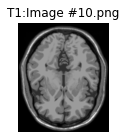

In [8]:
#Plotting the t1 images
plt.figure(figsize=(2,2))
plt.imshow(t1[0],cmap='gray')
plt.axis('off')
plt.title("T1:"+t1_images[0])
plt.show()
           

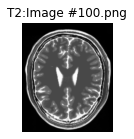

In [9]:
#Plotting the t2 images
plt.figure(figsize=(2,2))
plt.imshow(t2[0],cmap='gray')
plt.axis('off')
plt.title("T2:"+t2_images[0])
plt.show()

In [10]:
patht1 = os.path.join(os.getcwd(), 't1', 'TrainT1')
patht2 = os.path.join(os.getcwd(), 't2', 'TrainT2')
checkpoint_path = os.path.join(os.getcwd(), 'Trained_Model')

if not os.path.isdir(checkpoint_path):
    os.mkdir(checkpoint_path)

<a id="3.2"> </a>
### 3.2 Data Preprocessing
In Data Preprocessing we mainly do following operation:
1. Data Resizing
2. Data Reshaping
3. Batch and Shuffle Data


#### Resizing images (64,64)

In [11]:
#Creating function to resize the images
def resize_img(imgs):
    img_resized=np.zeros((imgs.shape[0],64,64))
    for index, img in enumerate(imgs):
        img_resized[index, :, :]=resize(img,(64,64))
    return img_resized

In [12]:
#Resizing the image (64, 64)
t1_resized=resize_img(t1)
t2_resized=resize_img(t2)
#Validating the resized image
print('Train T1 Shape:',t1_resized.shape)
print('Train T2 Shape:',t2_resized.shape)



Train T1 Shape: (43, 64, 64)
Train T2 Shape: (46, 64, 64)


#### Reshaping the images to (64,64,1) with float pixel values

In [13]:
#Reshaping the images
t1_resized=t1_resized.reshape(t1_resized.shape[0],64,64,1).astype('float32')
t2_resized=t2_resized.reshape(t2_resized.shape[0],64,64,1).astype('float32')
#Validating the resized image
print('Train T1 Shape:',t1_resized.shape)
print('Train T2 Shape:',t2_resized.shape)

Train T1 Shape: (43, 64, 64, 1)
Train T2 Shape: (46, 64, 64, 1)


#### Batch and shuffle the data

Here we declare the batch size and shuffle the data

In [14]:
#Declaring the batch size
BATCH_SIZE=1024

In [15]:
# Batch and shuffle the data
t1_resized=tf.data.Dataset.from_tensor_slices(t1_resized).shuffle(t1.shape[0],seed=42).batch(BATCH_SIZE)
t2_resized=tf.data.Dataset.from_tensor_slices(t2_resized).shuffle(t2.shape[0],seed=42).batch(BATCH_SIZE)


#### Visualizing the resized images randomly

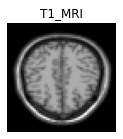

In [16]:
sample_t1=next(iter(t1_resized))
plt.figure(figsize=(2,2))
plt.imshow(sample_t1[0].numpy()[:,:,0], cmap='gray')
plt.title('T1_MRI')
plt.axis('off')
plt.show()

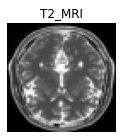

In [17]:
sample_t2=next(iter(t2_resized))
plt.figure(figsize=(2,2))
plt.imshow(sample_t2[0].numpy()[:,:,0], cmap='gray')
plt.title('T2_MRI')
plt.axis('off')
plt.show()

<a id="3.3"></a>
### 3.3 Model Building 
In model building we mainly perform following four operations.
1. Instance Normalization
2. Downsampling, Upsampling and Unet
3. Generator Building using unet
4. Discriminator Building

<a id="3.3.1"> </a>
#### Instance Normalization
Instance Normalization are specially used with Style Transfer, where Separate Normalization is performed for each sample we perform channelwise Normalization.

In [18]:
# class to implement instace normalization on images
class InstanceNormalization(tf.keras.layers.Layer):
    # Initialization of Objects
    def __init__(self, epsilon=1e-5):
        # calling parent's init
        super(InstanceNormalization, self).__init__()
        self.epsilon = epsilon
    
    def build(self, input_shape):
        self.scale = self.add_weight(
            name='scale',
            shape=input_shape[-1:],
            initializer=tf.random_normal_initializer(1., 0.02),
            trainable=True)
        self.offset = self.add_weight(
            name='offset',
            shape=input_shape[-1:],
            initializer='zeros',
            trainable=True)
    
    def call(self, x):
        # Compute Mean and Variance, Axes=[1,2] ensures Instance Normalization
        mean, variance = tf.nn.moments(x, axes=[1, 2], keepdims=True)
        inv = tf.math.rsqrt(variance + self.epsilon)
        normalized = (x - mean) * inv
        return self.scale * normalized + self.offset

<a id="3.3.2"></a>
#### Downsampling, Upsampling and Unet


##### Downsampling
Downsampling is performed using the convolution, leading to reduce in dimensions.

In [19]:
def downsample(filters, size,apply_norm=True):
    initializer=tf.random_normal_initializer(0., 0.02)
    result=tf.keras.Sequential()
    # Add conv2d layer
    result.add(tf.keras.layers.Conv2D(filters, size, strides=2, padding='same',
                                        kernel_initializer=initializer, use_bias=False))
    # Add Normalization layer
    if apply_norm:
        result.add(InstanceNormalization())
    # Add Leaky Relu Activation
    result.add(tf.keras.layers.LeakyReLU())
    return result

##### Upsampling
Upsampling is a result of Transposed Convolution, where dimension of image are increased.

In [20]:
def upsample(filters, size, apply_dropout=False):
    initializer = tf.random_normal_initializer(0., 0.02)
    result = tf.keras.Sequential()
    # Add Transposed Conv2d layer
    result.add(tf.keras.layers.Conv2DTranspose(filters, size, strides=2, padding='same',
                                               kernel_initializer=initializer, use_bias=False))
    # Add Normalization Layer
    result.add(InstanceNormalization())
    # Conditionally add Dropout layer
    if apply_dropout:
        result.add(tf.keras.layers.Dropout(0.5))
    # Add Relu Activation Layer
    result.add(tf.keras.layers.ReLU())
    return result

##### Unets
Unets takes Image as an input and translate it into another Image.

In [21]:
# Unet Generator is a combination of Convolution + Transposed Convolution Layers
def unet_generator():
    down_stack = [
        downsample(128, 4, False), # (bs, 32, 32, 128)
        downsample(256, 4), # (bs, 16, 16, 256)
        downsample(256, 4), # (bs, 8, 8, 256)
        downsample(256, 4), # (bs, 4, 4, 256)
        downsample(256, 4), # (bs, 2, 2, 256)
        downsample(256, 4) # (bs, 1, 1, 128)
    ]
    up_stack = [
        upsample(256, 4, True), # (bs, 2, 2, 256)
        upsample(256, 4, True), # (bs, 4, 4, 256)
        upsample(256, 4), # (bs, 8, 8, 256)
        upsample(256, 4), # (bs, 16, 16, 256)
        upsample(128, 4) # (bs, 32, 32, 128)
    ]
    initializer = tf.random_normal_initializer(0., 0.02)
    last = tf.keras.layers.Conv2DTranspose(1, 4, strides=2, padding='same', kernel_initializer=initializer,
                                           activation='tanh') # (bs, 64, 64, 1)
    concat = tf.keras.layers.Concatenate()
    inputs = tf.keras.layers.Input(shape=[64, 64, 1])
    x = inputs
    # Downsampling through the model
    skips = []
    for down in down_stack:
        x = down(x)
        skips.append(x)
    
    skips = reversed(skips[:-1])
    # Upsampling and establishing the skip connections
    for up, skip in zip(up_stack, skips):
        x = up(x)
        x = concat([x, skip])
    x = last(x)
    return tf.keras.Model(inputs=inputs, outputs=x)

<a id="3.3.3"></a>
#### Generator Building Using Unet
Generator is a Unet Network in which we translate one type of Image (T1) into another type of Image (T2).

In [22]:
#Creating generators
generator_g = unet_generator()
generator_f = unet_generator()

In [23]:
#Viewing summary of the generator
generator_g.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 64, 64, 1)]  0           []                               
                                                                                                  
 sequential (Sequential)        (None, 32, 32, 128)  2048        ['input_1[0][0]']                
                                                                                                  
 sequential_1 (Sequential)      (None, 16, 16, 256)  524800      ['sequential[0][0]']             
                                                                                                  
 sequential_2 (Sequential)      (None, 8, 8, 256)    1049088     ['sequential_1[0][0]']           
                                                                                              

<a id="3.3.4"></a>
#### Discriminator
Discriminator is a traditional CNN, which we use to classify the images. Since, it only uses Downsampling, so both Discriminators have same architecture

In [24]:
# Discriminators only contain Convolutional Layers and no Transposed Convolution is not used 
def discriminator():
    initializer = tf.random_normal_initializer(0., 0.02)
    # add input layer of size (64, 64, 1)
    inp = tf.keras.layers.Input(shape=[64, 64, 1], name='input_image')
    x = inp
    
    # add downsampling step here
    down1 = downsample(128, 4, False)(x) # (bs, 32, 32, 128)
    down2 = downsample(256, 4)(down1) # (bs, 16, 16, 128)
    # add a padding layer here
    zero_pad1 = tf.keras.layers.ZeroPadding2D()(down2) # (bs, 18, 18, 256)
    
    # implement a concrete downsampling layer here
    conv = tf.keras.layers.Conv2D(512, 4, strides=1, kernel_initializer=initializer,
                                  use_bias=False)(zero_pad1) # (bs, 15, 15, 512)
    norm1 = InstanceNormalization()(conv)
    leaky_relu = tf.keras.layers.LeakyReLU()(norm1)
    
    # apply zero padding layer
    zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu) # (bs, 17, 17, 512)
    
    # add a last pure 2D Convolution layer
    last = tf.keras.layers.Conv2D(1, 4, strides=1, kernel_initializer=initializer)(zero_pad2) # (bs, 14, 14, 1)
    return tf.keras.Model(inputs=inp, outputs=last)

In [25]:
#Creating discriminator
discriminator_x = discriminator()
discriminator_y = discriminator()

In [26]:
#Viewing summary of the discriminator
discriminator_x.summary()

Model: "model_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_image (InputLayer)    [(None, 64, 64, 1)]       0         
                                                                 
 sequential_22 (Sequential)  (None, 32, 32, 128)       2048      
                                                                 
 sequential_23 (Sequential)  (None, 16, 16, 256)       524800    
                                                                 
 zero_padding2d (ZeroPadding  (None, 18, 18, 256)      0         
 2D)                                                             
                                                                 
 conv2d_14 (Conv2D)          (None, 15, 15, 512)       2097152   
                                                                 
 instance_normalization_21 (  (None, 15, 15, 512)      1024      
 InstanceNormalization)                                    

<a id="3.4"></a>
### 3.4 Model Training
In model training we basically do follow operation for the model training.
1. Declare Loss type
2. Calculate Discriminator Loss
3. Calculate Generator Loss
4. Cycle Loss
5. Identity Loss
6. Optimizer
7. Checkpoint Initialization
8. Training Flow

Verify the output of the untrained generator models which should be a random noise

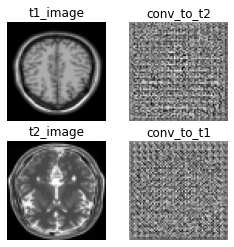

In [27]:
#Plotting the output of the untrained generator model
conv_to_t2=generator_g(sample_t2)
conv_to_t1=generator_f(sample_t1)
plt.figure(figsize=(4,4))

imgs=[sample_t1, conv_to_t2, sample_t2, conv_to_t1]
title=['t1_image','conv_to_t2', 't2_image','conv_to_t1']

for i in range(len(imgs)):
    plt.subplot(2,2,i+1)
    plt.title(title[i])
    plt.imshow(imgs[i][0].numpy()[:,:,0],cmap='gray')
    plt.axis('off')
plt.show()

#### Declare Loss as Binary Cross Entropy
Since our discriminator is a classifier so we take BCE loss

In [28]:
# Assigning the binary cross entropy loss
loss_obj = tf.keras.losses.BinaryCrossentropy(from_logits=True)

#### Discriminator Loss
It consists of two types of losses.
1.  Loss on Real Data
2.  Loss on Fake Data
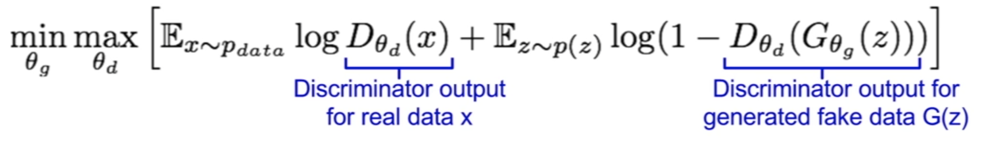

In [29]:
#Discriminator Loss: Real Loss + Fake Loss
def discriminator_loss(real, generated):
    real_loss = loss_obj(tf.ones_like(real), real)
    generated_loss = loss_obj(tf.zeros_like(generated),generated)
    total_disc_loss = real_loss + generated_loss
    return total_disc_loss*0.5 #mean of losses

#### Generator Loss
It has only one type of loss-Discriminator Loss on Generated data

In [30]:
#Defining the function for generator loss
def generator_loss(generated):
    return loss_obj(tf.ones_like(generated), generated)

#### Cylce Loss
When we use both of Generatores sequentially on a Input Image, we get Cycle Image and the L1 Loss between these two is called Cycle Loss
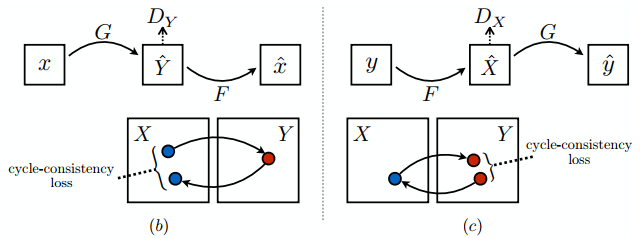

In [31]:
#Defining the function to calculate cycle loss
def calc_cycle_loss(real_image, cycled_image):
    loss1 = tf.reduce_mean(tf.abs(real_image - cycled_image))
    return 10.0 * loss1

#### Identity Loss
When we provide input image to the Generator such that no translation is needed because the Image is already transformed. Here we also take L1 Loss between Input and Output Image.
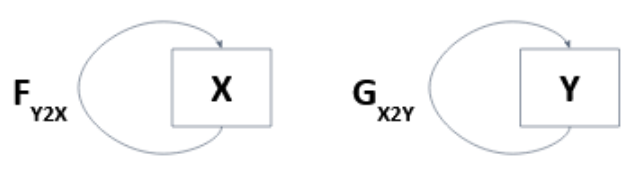

In [32]:
#Defining the function for identity loss
def identity_loss(real_image, same_image):
    loss = tf.reduce_mean(tf.abs(real_image - same_image))
    return 0.5*loss


#### Optimizer 
We use Adam Optimizer to update weights which is a good optimizer to achieve quick learning.

In [33]:
#Using Adam Optimizer to smoothen gradient descent
generator_g_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
generator_f_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

discriminator_x_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_y_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

We will train out Model for 300 Epochs

In [34]:
#Training model for 300 Epochs
EPOCH=300

#### Checkpoint Initialization

In [35]:
# Initialize checkpoints to save models
checkpoint_path = './Trained_Model'

# ckpt = tf.train.Checkpoint(generator_g=generator_g, 
#                         generator_f=generator_f, 
#                         discriminator_x=discriminator_x,
#                         discriminator_y=discriminator_y,
#                         generator_g_optimizer=generator_g_optimizer,
#                         generator_f_optimizer=generator_f_optimizer,
#                         discriminator_x_optimizer=discriminator_x_optimizer,
#                         discriminator_y_optimizer=discriminator_y_optimizer)
ckpt = tf.train.Checkpoint(generator_g=generator_g,
                           generator_f=generator_f,
                           discriminator_x=discriminator_x,
                           discriminator_y=discriminator_y,
                           generator_g_optimizer=generator_g_optimizer,
                           generator_f_optimizer=generator_f_optimizer,
                           discriminator_x_optimizer=discriminator_x_optimizer,
                           discriminator_y_optimizer=discriminator_y_optimizer)

ckpt_manager=tf.train.CheckpointManager(ckpt, checkpoint_path, max_to_keep=3)

#if a checkpoint exists, restore the latest checkpoint.
if ckpt_manager.latest_checkpoint:
    ckpt.restore(ckpt_manager.latest_checkpoint)
    print('Latest checkpoint restored!!')

In [36]:
# Funtion to show Images output by Generators while Training
def generate_images(model1, test_input1, model2, test_input2):
    prediction1 = model1(test_input1)
    prediction2 = model2(test_input2)
    plt.figure(figsize=(8,4))
    display_list = [test_input1[0], prediction1[0], test_input2[0], prediction2[0]]
    title = ['Input Image', 'Predicted Image', 'Input Image', 'Predicted Image']
    for i in range(4):
        plt.subplot(1, 4, i+1)
        plt.title(title[i])
        plt.imshow(display_list[i].numpy()[:, :, 0], cmap='gray')
        plt.axis('off')
    plt.savefig('image_at_epoch_{:04d}.png'.format(epoch))
    plt.show

#### Training Flow
Below Funtion performs one Flow of Batch Training

We can notice that Identity Loss and Cycle Loss are only unsed in training Generator and not Discriminator.

Sequence of Training Flow
1. Generate Fake Y and Cycled X
2. Generate Fake X and Cycled Y
3. Generate Fake Images through G and F for Identity Loss.
4. Calculate Discriminator Loss for Disc X and Disc Y on Faked Data for Generator Training
5. Calculate Generator Loss on Discriminator.
6. Calculate Cycled Loss on Cycled Images from step 1 and 2.
7. Calculate Total Generator Loss- Disc Loss + Cycled Loss + Identity Loss
8. Calculate Discriminator Loss on both Fake and Real Images for Disc X and Y for Disc Training.
9. Calculate the Gradients and update the weight and bias of models.

In [37]:
#Defining the Training Function
@tf.function
def train_step(real_x, real_y):
    # persistent is set to True because the tape is used more than
    # once to calculate the gradients
    with tf.GradientTape(persistent=True) as tape:
        # Generator G translate X -> Y
        # Generator F translates Y -> X
        fake_y = generator_g(real_x, training=True)
        cycled_x = generator_f(fake_y, training=True)

        fake_x = generator_f(real_y, training=True)
        cycled_y = generator_g(real_y, training=True)

        # same_x and same_y are used for identity loss.
        same_x = generator_f(real_x, training=True)
        same_y = generator_g(real_y, training=True)

        disc_real_x = discriminator_x(real_x, training=True)
        disc_real_y = discriminator_y(real_y,training=True)

        disc_fake_x = discriminator_x(fake_x, training=True)
        disc_fake_y = discriminator_y(fake_y, training=True)

        # Calculating the loss
        gen_g_loss = generator_loss(disc_fake_y)
        gen_f_loss = generator_loss(disc_fake_x)

        total_cycle_loss = calc_cycle_loss(real_x, cycled_x)+ calc_cycle_loss(real_y, cycled_y)
    

        #Total generator loss=BCE loss + cycle loss + identity loss
        total_gen_g_loss = gen_g_loss + total_cycle_loss + identity_loss(real_y, same_y)
        total_gen_f_loss = gen_f_loss + total_cycle_loss + identity_loss(real_x, same_x)

        # Discriminator's loss
        disc_x_loss = discriminator_loss(disc_real_x, disc_fake_x)
        disc_y_loss = discriminator_loss(disc_real_y, disc_fake_y)

    # Calculate the gradients for generator and discriminator
    generator_g_gradients = tape.gradient(total_gen_g_loss, generator_g.trainable_variables)
    generator_f_gradients = tape.gradient(total_gen_f_loss, generator_f.trainable_variables)

    discriminator_x_gradients = tape.gradient(disc_x_loss, discriminator_x.trainable_variables)
    discriminator_y_gradients = tape.gradient(disc_y_loss, discriminator_y.trainable_variables)

    # Apply the gradients to the optimizer
    generator_g_optimizer.apply_gradients(zip(generator_g_gradients, generator_g.trainable_variables))
    generator_f_optimizer.apply_gradients(zip(generator_f_gradients, generator_f.trainable_variables))

    discriminator_x_optimizer.apply_gradients(zip(discriminator_x_gradients, discriminator_x.trainable_variables))
    discriminator_y_optimizer.apply_gradients(zip(discriminator_y_gradients, discriminator_y.trainable_variables))


In [38]:
# Verify if GPU is set as the default device for training
tf.compat.v1.Session(config=tf.compat.v1.ConfigProto(log_device_placement=True))

Device mapping:
/job:localhost/replica:0/task:0/device:GPU:0 -> device: 0, name: NVIDIA GeForce RTX 3070 Laptop GPU, pci bus id: 0000:01:00.0, compute capability: 8.6



Saving checkpoint for epoch 1 at ./Trained_Model\ckpt-1
Saving checkpoint for epoch 2 at ./Trained_Model\ckpt-2
Saving checkpoint for epoch 3 at ./Trained_Model\ckpt-3
Saving checkpoint for epoch 4 at ./Trained_Model\ckpt-4
Saving checkpoint for epoch 5 at ./Trained_Model\ckpt-5
Saving checkpoint for epoch 6 at ./Trained_Model\ckpt-6
Saving checkpoint for epoch 7 at ./Trained_Model\ckpt-7
Saving checkpoint for epoch 8 at ./Trained_Model\ckpt-8
Saving checkpoint for epoch 9 at ./Trained_Model\ckpt-9
Saving checkpoint for epoch 10 at ./Trained_Model\ckpt-10
Saving checkpoint for epoch 11 at ./Trained_Model\ckpt-11
Saving checkpoint for epoch 12 at ./Trained_Model\ckpt-12
Saving checkpoint for epoch 13 at ./Trained_Model\ckpt-13
Saving checkpoint for epoch 14 at ./Trained_Model\ckpt-14
Saving checkpoint for epoch 15 at ./Trained_Model\ckpt-15
Saving checkpoint for epoch 16 at ./Trained_Model\ckpt-16
Saving checkpoint for epoch 17 at ./Trained_Model\ckpt-17
Saving checkpoint for epoch 18 a

C:\Users\ravip\AppData\Local\Temp/ipykernel_24236/233041240.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(8,4))


Saving checkpoint for epoch 21 at ./Trained_Model\ckpt-21
Saving checkpoint for epoch 22 at ./Trained_Model\ckpt-22
Saving checkpoint for epoch 23 at ./Trained_Model\ckpt-23
Saving checkpoint for epoch 24 at ./Trained_Model\ckpt-24
Saving checkpoint for epoch 25 at ./Trained_Model\ckpt-25
Saving checkpoint for epoch 26 at ./Trained_Model\ckpt-26
Saving checkpoint for epoch 27 at ./Trained_Model\ckpt-27
Saving checkpoint for epoch 28 at ./Trained_Model\ckpt-28
Saving checkpoint for epoch 29 at ./Trained_Model\ckpt-29
Saving checkpoint for epoch 30 at ./Trained_Model\ckpt-30
Saving checkpoint for epoch 31 at ./Trained_Model\ckpt-31
Saving checkpoint for epoch 32 at ./Trained_Model\ckpt-32
Saving checkpoint for epoch 33 at ./Trained_Model\ckpt-33
Saving checkpoint for epoch 34 at ./Trained_Model\ckpt-34
Saving checkpoint for epoch 35 at ./Trained_Model\ckpt-35
Saving checkpoint for epoch 36 at ./Trained_Model\ckpt-36
Saving checkpoint for epoch 37 at ./Trained_Model\ckpt-37
Saving checkpo

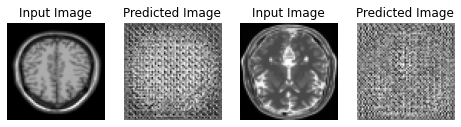

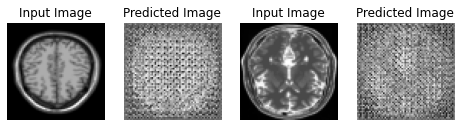

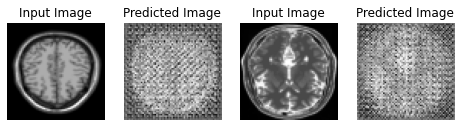

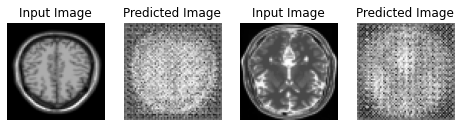

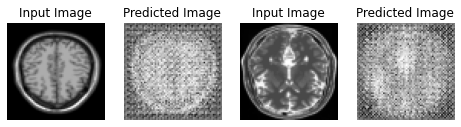

...

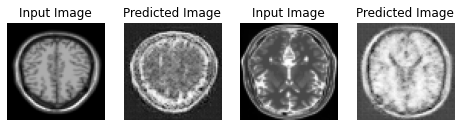

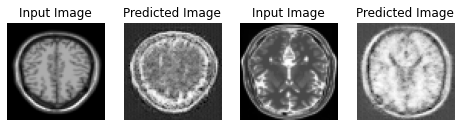

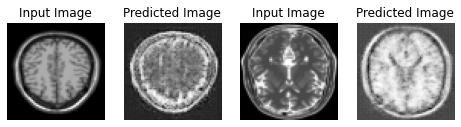

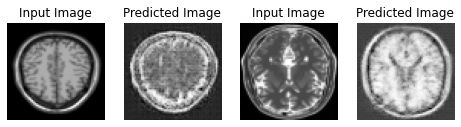

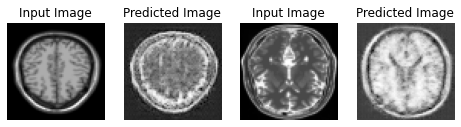

In [39]:
for epoch in range(1, EPOCH+1):
    for image_x, image_y in tf.data.Dataset.zip((t1_resized, t2_resized)):
        train_step(image_x, image_y)
    generate_images(generator_g, sample_t1, generator_f, sample_t2)
    ckpt_save_path = ckpt_manager.save()
    print('Saving checkpoint for epoch', epoch, 'at', ckpt_save_path)


<a id="4"></a> 
## 4. Result

Generationg GIF to Visualize Results

In [40]:
#Generating GIF
anime_file = 'mri_cyclegan.gif'

with imageio.get_writer(anime_file, mode='I') as writer:
    filenames = glob.glob('image*.png')
    filenames = sorted(filenames)
    for filename in filenames:
        image = imageio.imread(filename)
        writer.append_data(image)
    image = imageio.imread(filename)



In [41]:
#installing the required libraries
!pip install git+https://github.com/tensorflow/docs

  Cloning https://github.com/tensorflow/docs to c:\users\ravip\appdata\local\temp\pip-req-build-6x7yvv5d
  Resolved https://github.com/tensorflow/docs to commit 6c5d6ef90004307b41b0bcac30b7b1363ae26129


  Running command git clone -q https://github.com/tensorflow/docs 'C:\Users\ravip\AppData\Local\Temp\pip-req-build-6x7yvv5d'



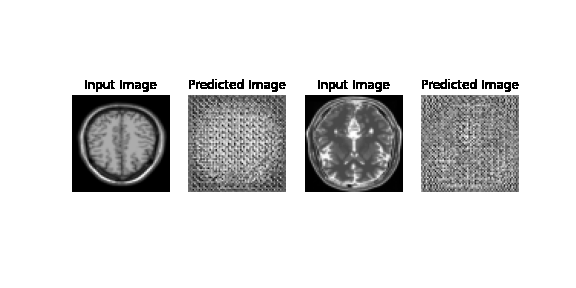

In [42]:
#plotting the gif image
import tensorflow_docs.vis.embed as embed
embed.embed_file(anime_file)

The result obtained above shows that our model successfully generated artificial MRI images from the exsiting MRI scans.

<a id="5"></a> 
## 5. Conclusion
Finally we can see the above result and conclude that our model successfully translated the style of one MRI image T1  to another image T2 and vice versa by using CycleGAN-based framework.

In this capstone project, we performed image translation to MRI brain images only. Hence, we can extend this CycleGAN-based framework to other medical imaging pipelines that require unpaired image translation.


<a id="6"></a> 
## 6. References
* Zhu, J. Y., Park, T., Isola, P., & Efros, A. A. (2017). Unpaired image-to-image translation using cycle-consistent adversarial networks. In Proceedings of the IEEE international conference on computer vision (pp. 2223-2232).
* Magnetic Resonance Imaging (MRI) of the Brain and Spine: https://case.edu/med/neurology/NR/MRI%20Basics.htm
* Mohsen, H., El-Dahshan, E. S. A., El-Horbaty, E. S. M., & Salem, A. B. M. (2018). Classification using deep learning neural networks for brain tumors. Future Computing and Informatics Journal, 3(1), 68-71.

![](https://imgscf.slidemembers.com/docs/1/1/356/thank_you_355048.jpg)